In [74]:
import torch
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0))

True
NVIDIA GeForce RTX 3070


In [2]:
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

if torch.cuda.is_available():
    print("GPU:", torch.cuda.get_device_name(0))

Using device: cuda
GPU: NVIDIA GeForce RTX 3070


## Imports

In [3]:
import json
from copy import deepcopy

import torch
import torchvision
from torchvision.models.detection import retinanet_resnet50_fpn
from torchvision.transforms import functional as F

import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from torchvision.datasets import CocoDetection

from PIL import ImageOps
from torch.utils.data import DataLoader


## Clean JSON (keeping only required attributes/info)

In [4]:


# ---- paths ----
INPUT_JSON = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/COCO-based_COCO_mounting/images/val/val.json"      # your current file
OUTPUT_JSON = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/COCO-based_COCO_mounting/images/val/val_annotations_mounting.json"   # clean output

with open(INPUT_JSON, "r") as f:
    coco = json.load(f)

clean_coco = {
    "info": coco.get("info", {}),
    "licenses": coco.get("licenses", []),
    "images": coco["images"],
    "annotations": [],
    "categories": [
        {"id": 1, "name": "pole"},
        {"id": 2, "name": "wall"}
    ]
}

for ann in coco["annotations"]:
    clean_ann = {
        "id": ann["id"],
        "image_id": ann["image_id"],
        "category_id": ann["category_id"],
        "bbox": ann["bbox"],
        "area": ann.get("area", ann["bbox"][2] * ann["bbox"][3]),
        "iscrowd": ann.get("iscrowd", 0)
    }
    clean_coco["annotations"].append(clean_ann)

with open(OUTPUT_JSON, "w") as f:
    json.dump(clean_coco, f, indent=2)

print(f"Clean mounting JSON saved to: {OUTPUT_JSON}")
print(f"Images: {len(clean_coco['images'])}")
print(f"Annotations: {len(clean_coco['annotations'])}")


Clean mounting JSON saved to: D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/COCO-based_COCO_mounting/images/val/val_annotations_mounting.json
Images: 133
Annotations: 185


## Dataset class (RetinaNet-compatible)

In [5]:
class MountingCocoDataset(CocoDetection):
    def __init__(self, img_dir, ann_file):
        super().__init__(img_dir, ann_file)

    def __getitem__(self, idx):
        image, anns = super().__getitem__(idx)

        # ✅ FIX EXIF ORIENTATION (VERY IMPORTANT)
        image = ImageOps.exif_transpose(image)

        image = F.to_tensor(image)

        boxes = []
        labels = []

        for ann in anns:
            x, y, w, h = ann["bbox"]
            boxes.append([x, y, x + w, y + h])
            labels.append(ann["category_id"])

        target = {
            "boxes": torch.tensor(boxes, dtype=torch.float32),
            "labels": torch.tensor(labels, dtype=torch.int64)
        }

        return image, target


## Dataset paths & loaders

In [6]:
TRAIN_IMG_DIR = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/COCO-based_COCO_mounting/images/train/images"
TRAIN_ANN = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/COCO-based_COCO_mounting/images/train/train_annotations_mounting.json"

VAL_IMG_DIR = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/COCO-based_COCO_mounting/images/val/images"
VAL_ANN = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/COCO-based_COCO_mounting/images/val/val_annotations_mounting.json"

In [7]:
train_dataset = MountingCocoDataset(TRAIN_IMG_DIR, TRAIN_ANN)
val_dataset   = MountingCocoDataset(VAL_IMG_DIR, VAL_ANN)

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [8]:

def collate_fn(batch):
    return tuple(zip(*batch))

train_loader = DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    collate_fn=collate_fn
)

val_loader = DataLoader(
    val_dataset,
    batch_size=2,
    shuffle=False,
    collate_fn=collate_fn
)


## Building RetinaNet model

In [75]:
from torchvision.models.detection import retinanet_resnet50_fpn
from torchvision.models import ResNet50_Weights


model = retinanet_resnet50_fpn(
    weights=None,  # no COCO detection head
    weights_backbone=ResNet50_Weights.DEFAULT,  # ImageNet-pretrained backbone
    num_classes=3  # background + pole + wall
)

model.to(device)


RetinaNet(
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=1e-05)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=1e-05)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=1e-05)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(256, e

## Optimiser & training setup

In [76]:
optimizer = torch.optim.AdamW(
    model.parameters(),
    lr=1e-4,
    weight_decay=1e-4
)

## Training loop

In [11]:
train_losses = []
val_losses = []

In [12]:
NUM_EPOCHS = 20

model.train()

for epoch in range(NUM_EPOCHS):
    epoch_loss = 0

    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        train_losses.append(epoch_loss)

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        epoch_loss += losses.item()

    print(f"Epoch [{epoch+1}/{NUM_EPOCHS}] - Loss: {epoch_loss:.2f}")

Epoch [1/20] - Loss: 204.35
Epoch [2/20] - Loss: 116.32
Epoch [3/20] - Loss: 77.76
Epoch [4/20] - Loss: 63.16
Epoch [5/20] - Loss: 56.23
Epoch [6/20] - Loss: 51.36
Epoch [7/20] - Loss: 48.11
Epoch [8/20] - Loss: 44.12
Epoch [9/20] - Loss: 40.88
Epoch [10/20] - Loss: 36.50
Epoch [11/20] - Loss: 33.20
Epoch [12/20] - Loss: 33.76
Epoch [13/20] - Loss: 27.97
Epoch [14/20] - Loss: 24.33
Epoch [15/20] - Loss: 22.95
Epoch [16/20] - Loss: 20.13
Epoch [17/20] - Loss: 19.00
Epoch [18/20] - Loss: 23.15
Epoch [19/20] - Loss: 31.30
Epoch [20/20] - Loss: 27.63


## Saving model

In [13]:
MODEL_PATH = "retinanet_mounting_type.pth"
torch.save(model.state_dict(), MODEL_PATH)

print("Model saved to:", MODEL_PATH)

Model saved to: retinanet_mounting_type.pth


In [21]:
import torch
from torchvision.models.detection import retinanet_resnet50_fpn

num_classes = 3  # <-- MUST match training (background + classes)

model = retinanet_resnet50_fpn(
    weights=None,
    num_classes=num_classes
)

model.load_state_dict(torch.load("retinanet_mounting_type.pth", map_location=device))
model.to(device)
model.eval()
print("Model loaded and set to eval mode.")

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to C:\Users\USER/.cache\torch\hub\checkpoints\resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:15<00:00, 6.50MB/s]
C:\Users\USER\AppData\Local\Temp\ipykernel_104656\1215785234.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where

Model loaded and set to eval mode.


In [53]:
LABEL_MAP = {
    1: "Pole-mounted",
    2: "Wall-mounted"
}

def draw_predictions(image, boxes, scores, labels, conf_thr=0.5):
    img = image.copy()

    for box, score, label in zip(boxes, scores, labels):
        if score < conf_thr:
            continue

        x1, y1, x2, y2 = map(int, box)
        label_name = LABEL_MAP.get(int(label), "Unknown")

        # Bounding box size
        box_h = y2 - y1

        # 🔑 Adaptive font scale (clamped)
        font_scale = max(2, min(3, box_h / 120))
        thickness = max(2, int(font_scale * 2))

        font = cv2.FONT_HERSHEY_SIMPLEX
        text = f"{label_name} ({score:.2f})"

        # Text size
        (tw, th), _ = cv2.getTextSize(text, font, font_scale, thickness)

        # Bounding box
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), thickness + 1)

        # Background rectangle
        cv2.rectangle(
            img,
            (x1, max(0, y1 - th - 10)),
            (x1 + tw + 6, y1),
            (0, 255, 0),
            -1
        )

        # Text
        cv2.putText(
            img,
            text,
            (x1 + 3, y1 - 6),
            font,
            font_scale,
            (0, 0, 0),
            thickness,
            cv2.LINE_AA
        )

    return img




In [54]:
import os
import math
import matplotlib.pyplot as plt
from torchvision import transforms
TEST_IMG_DIR = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/COCO-based_COCO_mounting/images/test/images"

transform = transforms.ToTensor()
image_files = sorted(os.listdir(TEST_IMG_DIR))

visuals = []

with torch.no_grad():
    for img_name in image_files:
        img_path = os.path.join(TEST_IMG_DIR, img_name)

        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        input_tensor = transform(img_rgb).unsqueeze(0).to(device)

        output = model(input_tensor)[0]

        drawn = draw_predictions(
            img_rgb,
            output["boxes"].cpu(),
            output["scores"].cpu(),
            output["labels"].cpu(),
            conf_thr=0.5
        )

        visuals.append(drawn)


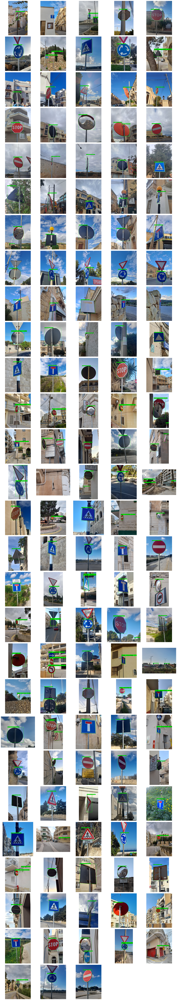

In [55]:
cols = 5
rows = math.ceil(len(visuals) / cols)

plt.figure(figsize=(20, rows * 4))

for i, img in enumerate(visuals):
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img)
    plt.axis("off")

plt.tight_layout()
plt.show()


## Validation / inference with confidence threshold

In [14]:
model.eval()

CONF_THRESH = 0.5

with torch.no_grad():
    images, targets = next(iter(val_loader))
    img = images[0].to(device)

    output = model([img])[0]

    keep = output["scores"] > CONF_THRESH

    boxes = output["boxes"][keep]
    labels = output["labels"][keep]
    scores = output["scores"][keep]


## Visualise predictions

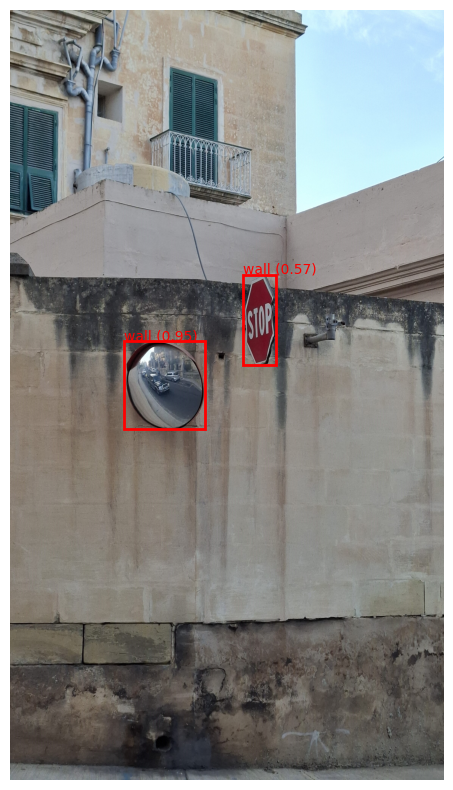

In [15]:
img_np = img.permute(1, 2, 0).cpu().numpy()

plt.figure(figsize=(6, 10))
plt.imshow(img_np)
plt.axis("off")

for box, label, score in zip(boxes, labels, scores):
    x1, y1, x2, y2 = box.cpu().numpy()
    cls = "pole" if label == 1 else "wall"
    plt.gca().add_patch(
        plt.Rectangle((x1, y1), x2-x1, y2-y1,
                      fill=False, edgecolor="red", linewidth=2)
    )
    plt.text(x1, y1-5, f"{cls} ({score:.2f})", color="red")

plt.show()

## mAP (Mean Average Precision)

In [16]:
from torchmetrics.detection.mean_ap import MeanAveragePrecision
import torch

metric_map = MeanAveragePrecision(iou_type="bbox")

model.eval()

with torch.no_grad():
    for images, targets in val_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        outputs = model(images)

        preds = []
        gts = []

        for out, tgt in zip(outputs, targets):
            preds.append({
                "boxes": out["boxes"].cpu(),
                "scores": out["scores"].cpu(),
                "labels": out["labels"].cpu()
            })
            gts.append({
                "boxes": tgt["boxes"].cpu(),
                "labels": tgt["labels"].cpu()
            })

        metric_map.update(preds, gts)

map_results = metric_map.compute()
map_results


{'map': tensor(0.5552),
 'map_50': tensor(0.7803),
 'map_75': tensor(0.6205),
 'map_small': tensor(0.),
 'map_medium': tensor(0.1847),
 'map_large': tensor(0.6212),
 'mar_1': tensor(0.5493),
 'mar_10': tensor(0.6485),
 'mar_100': tensor(0.6491),
 'mar_small': tensor(0.),
 'mar_medium': tensor(0.3780),
 'mar_large': tensor(0.6987),
 'map_per_class': tensor(-1.),
 'mar_100_per_class': tensor(-1.),
 'classes': tensor([1, 2], dtype=torch.int32)}

## Precision, Recall, F1-score

In [61]:
import numpy as np

CONF_THRESH = 0.5
TP = FP = FN = 0

def iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (boxA[2]-boxA[0]) * (boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0]) * (boxB[3]-boxB[1])

    return inter / (areaA + areaB - inter + 1e-6)

IOU_THRESH = 0.5

model.eval()
with torch.no_grad():
    for images, targets in val_loader:
        images = [img.to(device) for img in images]
        outputs = model(images)

        for out, tgt in zip(outputs, targets):
            keep = out["scores"] > CONF_THRESH
            pred_boxes = out["boxes"][keep].cpu().numpy()
            gt_boxes = tgt["boxes"].cpu().numpy()

            matched = set()
            for pb in pred_boxes:
                found = False
                for i, gb in enumerate(gt_boxes):
                    if i not in matched and iou(pb, gb) > IOU_THRESH:
                        TP += 1
                        matched.add(i)
                        found = True
                        break
                if not found:
                    FP += 1

            FN += len(gt_boxes) - len(matched)


In [62]:
precision = TP / (TP + FP + 1e-6)
recall = TP / (TP + FN + 1e-6)
f1 = 2 * precision * recall / (precision + recall + 1e-6)

print(f"Precision: {precision:.3f}")
print(f"Recall:    {recall:.3f}")
print(f"F1-score:  {f1:.3f}")

Precision: 0.923
Recall:    0.773
F1-score:  0.841


## Inference Speed

In [19]:
import time

model.eval()
images, _ = next(iter(val_loader))
images = [img.to(device) for img in images]

# Warm-up
with torch.no_grad():
    model(images)

N = 50
start = time.time()

with torch.no_grad():
    for _ in range(N):
        model(images)

elapsed = time.time() - start
fps = (N * len(images)) / elapsed

print(f"Inference speed: {fps:.2f} FPS")

Inference speed: 13.44 FPS


## Confusion Matrix

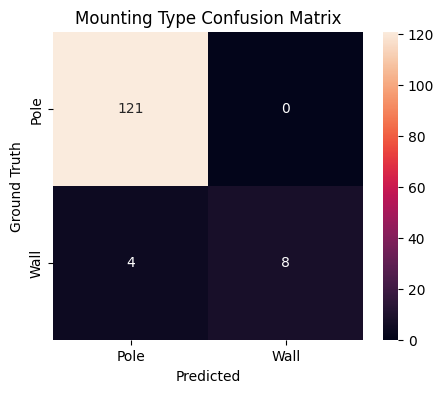

In [64]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

y_true = []
y_pred = []

model.eval()
with torch.no_grad():
    for images, targets in val_loader:
        images = [img.to(device) for img in images]
        outputs = model(images)

        for out, tgt in zip(outputs, targets):
            if len(out["scores"]) == 0:
                continue
            best = torch.argmax(out["scores"])
            y_pred.append(out["labels"][best].item())
            y_true.append(tgt["labels"][0].item())

cm = confusion_matrix(y_true, y_pred, labels=[1, 2])

plt.figure(figsize=(5,4))
sns.heatmap(cm, annot=True, fmt="d",
            xticklabels=["Pole", "Wall"],
            yticklabels=["Pole", "Wall"])
plt.xlabel("Predicted")
plt.ylabel("Ground Truth")
plt.title("Mounting Type Confusion Matrix")
plt.show()


## Training vs Validation Loss Graph

In [70]:
model.train()   # REQUIRED for loss computation
train_losses = []
val_losses = []

for epoch in range(20):
    model.train()
    epoch_train_loss = 0.0

    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        loss = sum(loss_dict.values())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_train_loss += loss.item()

    epoch_train_loss /= len(train_loader)
    train_losses.append(epoch_train_loss)

    model.train()  # required for loss computation
    epoch_val_loss = 0.0

    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            loss = sum(loss_dict.values())
            epoch_val_loss += loss.item()

    epoch_val_loss /= len(val_loader)
    val_losses.append(epoch_val_loss)

    model.eval()



KeyboardInterrupt: 

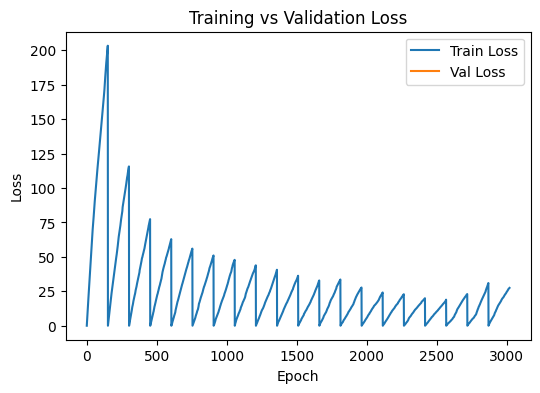

In [ ]:
plt.figure(figsize=(6,4))
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.title("Training vs Validation Loss")
plt.show()

## Ground Truth vs Predictions

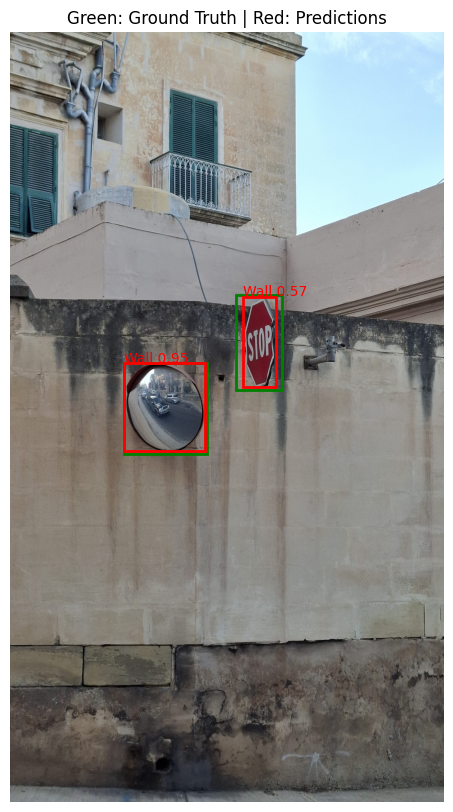

GT objects: 2
Predicted objects: 2


In [58]:
image, target = val_dataset[0]
model.eval()

with torch.no_grad():
    output = model([image.to(device)])[0]

keep = output["scores"] > 0.5

img = image.permute(1,2,0).numpy()

plt.figure(figsize=(6,10))
plt.imshow(img)
plt.axis("off")

# GT
for box in target["boxes"]:
    x1,y1,x2,y2 = box
    plt.gca().add_patch(
        plt.Rectangle((x1,y1),x2-x1,y2-y1,
                      edgecolor="green",fill=False,linewidth=2)
    )

# Predictions
for box, label, score in zip(
    output["boxes"][keep],
    output["labels"][keep],
    output["scores"][keep]
):
    x1,y1,x2,y2 = box.cpu()
    cls = "Pole" if label==1 else "Wall"
    plt.text(x1,y1-5,f"{cls} {score:.2f}",color="red")
    plt.gca().add_patch(
        plt.Rectangle((x1,y1),x2-x1,y2-y1,
                      edgecolor="red",fill=False,linewidth=2)
    )

plt.title("Green: Ground Truth | Red: Predictions")
plt.show()

print("GT objects:", len(target["boxes"]))
print("Predicted objects:", keep.sum().item())

## Second Run

In [ ]:
NUM_EPOCHS = 30
PATIENCE = 5

train_losses = []
val_losses = []

best_val_loss = float("inf")
epochs_no_improve = 0

BEST_MODEL_PATH = "models/retinanet_mounting_best.pth"
LAST_MODEL_PATH = "models/retinanet_mounting_last.pth"

In [ ]:
for epoch in range(NUM_EPOCHS):
    print(f"\nEpoch [{epoch+1}/{NUM_EPOCHS}]")

    # -------- TRAIN --------
    model.train()
    epoch_train_loss = 0.0

    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        loss = sum(loss_dict.values())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_train_loss += loss.item()

    epoch_train_loss /= len(train_loader)
    train_losses.append(epoch_train_loss)

    # -------- VALIDATION --------
    model.train()  # REQUIRED for loss computation
    epoch_val_loss = 0.0

    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            loss = sum(loss_dict.values())
            epoch_val_loss += loss.item()

    epoch_val_loss /= len(val_loader)
    val_losses.append(epoch_val_loss)

    print(f"Train Loss: {epoch_train_loss:.4f}")
    print(f"Val   Loss: {epoch_val_loss:.4f}")

    # -------- EARLY STOPPING --------
    if epoch_val_loss < best_val_loss:
        best_val_loss = epoch_val_loss
        epochs_no_improve = 0
        torch.save(model.state_dict(), BEST_MODEL_PATH)
        print("✅ Best model saved")
    else:
        epochs_no_improve += 1
        print(f"⚠ No improvement ({epochs_no_improve}/{PATIENCE})")

    torch.save(model.state_dict(), LAST_MODEL_PATH)

    if epochs_no_improve >= PATIENCE:
        print("🛑 Early stopping triggered")
        break

    model.eval()


In [ ]:
model.load_state_dict(torch.load(BEST_MODEL_PATH))
model.to(device)
model.eval()

In [ ]:
import pandas as pd
import os

os.makedirs("results", exist_ok=True)

loss_df = pd.DataFrame({
    "epoch": range(1, len(train_losses) + 1),
    "train_loss": train_losses,
    "val_loss": val_losses
})

loss_df.to_csv("results/train_val_loss_mounting.csv", index=False)